**The following SQL and python codes may not be optimal but they are good to start.**

# [MIMIC II Database] (https://physionet.org/mimic2/)

The MIMIC II (Multiparameter Intelligent Monitoring in Intensive Care) Databases contain physiologic signals and vital signs time series captured from patient monitors, and comprehensive clinical data obtained from hospital medical information systems, for tens of thousands of Intensive Care Unit (ICU) patients*. Data were collected between 2001 and 2008 from a variety of ICUs (medical, surgical, coronary care, and neonatal) in a single tertiary teaching hospital.

[Useful introduction](https://physionet.org/mimic2/demo/MIMICIICookBook_v1.pdf)

## Research Question

We need to predict the visit ICU mortality using the first 48 hrs. from the admission time?

### Features (predictors + outcome)

1. Predictors:
    - [patient demographics data](http://www.macadamian.com/2011/12/21/patient-demographics/): Age, gender, race, religion, ethnicity, etc.
    - [comorbidities](https://migraine.com/blog/what-is-a-comorbid-condition-a-bulleted-list-for-patients/): ??
    - [repeated measurements](https://migraine.com/blog/what-is-a-comorbid-condition-a-bulleted-list-for-patients/): Lab tests, vital signs, medictions, io chart values, or any timestamped measurements.
    - Others: clinical notes, images,.. (Not included)
2. Outcome: Mortality (yes/no)

### Hint: 
- Here will pull data as a toy example for around 1874 patients data. 
- There are more efficient ways and research paradigms to achieve more accurate results.


In [1]:
# Impoart python libraries and SQL interface

import pymysql
import pandas as pd
import getpass
from IPython.display import display, HTML

In [2]:
# Open remote SQL connection 

conn = pymysql.connect(host="mysql",
                       port=3306,user="jovyan",
                       passwd=getpass.getpass("Enter MySQL password for jovyan"),db='mimic2')
cursor = conn.cursor()

Enter MySQL password for jovyan········


In [4]:
# Show the MIMIC II tables
# Analyze the structure of some tables

tables = pd.read_sql("""SHOW TABLES""", conn)
sql_queries= [(t,"SHOW COLUMNS FROM %s"%t) for t in tables["Tables_in_mimic2"]]
for q in sql_queries:
    display(HTML("<h2>%s</h2>"%q[0]))
    display(HTML(pd.read_sql(q[1], conn).to_html()))

,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,icustay_id,int(11),YES,MUL,None,
2,itemid,int(11),NO,MUL,None,
3,elemid,int(11),NO,,None,
4,starttime,datetime,NO,,None,
5,startrealtime,datetime,NO,,None,
6,endtime,datetime,YES,,None,
7,cuid,int(11),YES,MUL,None,
8,duration,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,PRI,None,
1,icustay_id,int(11),YES,MUL,None,
2,itemid,int(11),NO,PRI,None,
3,elemid,int(11),NO,PRI,None,
4,starttime,datetime,NO,PRI,None,
5,startrealtime,datetime,YES,,None,
6,endtime,datetime,YES,,None,
7,cuid,int(11),YES,MUL,None,
8,duration,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,PRI,None,
1,icustay_id,int(11),YES,MUL,None,
2,itemid,int(11),NO,PRI,None,
3,elemid,int(11),NO,PRI,None,
4,starttime,datetime,NO,PRI,None,
5,startrealtime,datetime,YES,,None,
6,endtime,datetime,YES,,None,
7,cuid,int(11),YES,MUL,None,
8,duration,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,icustay_id,int(11),YES,MUL,None,
2,itemid,int(11),NO,MUL,None,
3,ioitemid,int(11),NO,MUL,None,
4,charttime,datetime,NO,,None,
5,elemid,int(11),NO,,None,
6,cgid,int(11),YES,MUL,None,
7,cuid,int(11),YES,MUL,None,
8,amount,double,YES,,None,
9,doseunits,varchar(20),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,hadm_id,int(11),NO,PRI,None,
1,subject_id,int(11),NO,MUL,None,
2,admit_dt,datetime,NO,,None,
3,disch_dt,datetime,NO,,None,


,Field,Type,Null,Key,Default,Extra
0,census_id,int(11),NO,PRI,None,
1,subject_id,int(11),NO,MUL,None,
2,intime,datetime,NO,,None,
3,outtime,datetime,NO,,None,
4,careunit,int(11),YES,MUL,None,
5,destcareunit,int(11),YES,MUL,None,
6,dischstatus,varchar(20),YES,,None,
7,los,double,YES,,None,
8,icustay_id,int(11),YES,MUL,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,icustay_id,int(11),YES,MUL,None,
2,itemid,int(11),NO,MUL,None,
3,charttime,datetime,NO,MUL,None,
4,elemid,int(11),NO,,None,
5,realtime,datetime,NO,,None,
6,cgid,int(11),YES,MUL,None,
7,cuid,int(11),YES,MUL,None,
8,value1,varchar(110),YES,,None,
9,value1num,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,hadm_id,int(11),NO,MUL,None,
2,category,char(10),YES,,None,
3,congestive_heart_failure,double,YES,,None,
4,cardiac_arrhythmias,double,YES,,None,
5,valvular_disease,double,YES,,None,
6,pulmonary_circulation,double,YES,,None,
7,peripheral_vascular,double,YES,,None,
8,hypertension,double,YES,,None,
9,paralysis,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,cgid,int(11),NO,PRI,None,
1,label,varchar(6),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,cuid,int(11),NO,PRI,None,
1,label,varchar(20),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,itemid,int(11),NO,PRI,None,
1,label,varchar(110),YES,,None,
2,category,varchar(50),YES,,None,
3,description,varchar(255),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,label,varchar(110),YES,,None,
1,label_lower,varchar(110),YES,MUL,None,
2,itemid,int(11),YES,UNI,None,
3,category,varchar(50),YES,,None,
4,description,varchar(255),YES,,None,
5,value_type,char(1),YES,,None,
6,value_column,varchar(6),YES,,None,
7,rows_num,double,YES,,None,
8,subjects_num,double,YES,,None,
9,chart_vs_realtime_delay_mean,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,itemid,int(11),NO,PRI,None,
1,code,varchar(10),YES,,None,
2,type,varchar(12),YES,,None,
3,category,varchar(13),YES,,None,
4,label,varchar(100),YES,,None,
5,description,varchar(100),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,itemid,int(11),NO,PRI,None,
1,label,varchar(50),YES,,None,
2,category,varchar(19),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,itemid,int(11),NO,PRI,None,
1,label,varchar(600),YES,,None,
2,category,varchar(50),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,itemid,int(11),NO,PRI,None,
1,test_name,varchar(50),NO,,None,
2,fluid,varchar(50),NO,,None,
3,category,varchar(50),NO,,None,
4,loinc_code,varchar(7),YES,,None,
5,loinc_description,varchar(100),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,itemid,int(11),NO,PRI,None,
1,label,varchar(20),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,category,varchar(50),NO,,None,
1,description,varchar(500),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,PRI,None,
1,sex,varchar(1),YES,,None,
2,dob,datetime,NO,,None,
3,dod,datetime,YES,,None,
4,hospital_expire_flg,varchar(1),YES,,N,


,Field,Type,Null,Key,Default,Extra
0,created_dt,datetime,YES,,None,
1,created_by,varchar(15),YES,,None,
2,updated_dt,datetime,YES,,None,
3,updated_by,varchar(15),YES,,None,
4,schema_dt,datetime,YES,,None,
5,version,varchar(25),NO,,None,
6,comments,varchar(250),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,PRI,None,
1,icustay_id,int(11),YES,MUL,None,
2,ioitemid,int(11),NO,PRI,None,
3,charttime,datetime,NO,PRI,None,
4,elemid,int(11),NO,PRI,None,
5,cgid,int(11),YES,MUL,None,
6,cuid,int(11),YES,MUL,None,
7,site,varchar(20),YES,,None,
8,rate,double,YES,,None,
9,rateuom,varchar(20),NO,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,,None,
1,hadm_id,int(11),NO,,None,
2,marital_status_itemid,int(11),YES,,None,
3,marital_status_descr,varchar(50),YES,,None,
4,ethnicity_itemid,int(11),YES,,None,
5,ethnicity_descr,varchar(50),YES,,None,
6,overall_payor_group_itemid,int(11),YES,,None,
7,overall_payor_group_descr,varchar(50),YES,,None,
8,religion_itemid,int(11),YES,,None,
9,religion_descr,varchar(50),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,PRI,None,
1,hadm_id,int(11),NO,PRI,None,
2,itemid,int(11),NO,PRI,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,PRI,None,
1,hadm_id,int(11),NO,PRI,None,
2,itemid,int(11),NO,PRI,None,
3,cost_weight,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,hadm_id,int(11),NO,MUL,None,
2,sequence,int(11),NO,,None,
3,code,varchar(100),NO,,None,
4,description,varchar(255),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,icustay_id,int(11),YES,MUL,None,
1,subject_id,int(11),YES,,None,
2,seq,int(11),YES,,None,
3,begintime,datetime,YES,,None,
4,endtime,datetime,YES,,None,
5,first_day_flg,char(1),YES,,None,
6,last_day_flg,char(1),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,icustay_id,int(11),YES,UNI,None,
1,subject_id,int(11),YES,MUL,None,
2,gender,varchar(1),YES,,None,
3,dob,datetime,NO,,None,
4,dod,datetime,YES,,None,
5,expire_flg,varchar(1),YES,,None,
6,subject_icustay_total_num,double,YES,,None,
7,subject_icustay_seq,double,YES,,None,
8,hadm_id,int(11),YES,,None,
9,hospital_total_num,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,icustay_id,int(11),NO,PRI,None,
1,subject_id,int(11),NO,MUL,None,
2,intime,datetime,NO,MUL,None,
3,outtime,datetime,NO,MUL,None,
4,los,double,NO,,None,
5,first_careunit,int(11),YES,MUL,None,
6,last_careunit,int(11),YES,MUL,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,icustay_id,int(11),YES,MUL,None,
2,itemid,int(11),NO,MUL,None,
3,charttime,datetime,NO,,None,
4,elemid,int(11),NO,,None,
5,altid,int(11),YES,MUL,None,
6,realtime,datetime,YES,,None,
7,cgid,int(11),YES,MUL,None,
8,cuid,int(11),YES,MUL,None,
9,volume,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,hadm_id,int(11),YES,MUL,None,
2,icustay_id,int(11),YES,MUL,None,
3,itemid,int(11),NO,MUL,None,
4,charttime,datetime,NO,,None,
5,value,varchar(100),YES,,None,
6,valuenum,double,YES,,None,
7,flag,varchar(10),YES,,None,
8,valueuom,varchar(10),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,PRI,None,
1,icustay_id,int(11),YES,MUL,None,
2,itemid,int(11),NO,PRI,None,
3,charttime,datetime,NO,PRI,None,
4,elemid,int(11),NO,PRI,None,
5,realtime,datetime,NO,,None,
6,cgid,int(11),YES,MUL,None,
7,cuid,int(11),YES,MUL,None,
8,volume,double,YES,,None,
9,dose,double,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),YES,MUL,None,
1,hadm_id,int(11),YES,MUL,None,
2,charttime,datetime,YES,,None,
3,spec_itemid,int(11),YES,MUL,None,
4,org_itemid,int(11),YES,MUL,None,
5,isolate_num,double,YES,,None,
6,ab_itemid,int(11),YES,MUL,None,
7,dilution_amount,varchar(72),YES,,None,
8,dilution_comparison,varchar(10),YES,,None,
9,interpretation,varchar(1),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,hadm_id,int(11),YES,MUL,None,
2,icustay_id,int(11),YES,MUL,None,
3,elemid,int(11),YES,,None,
4,charttime,datetime,NO,,None,
5,realtime,datetime,YES,,None,
6,cgid,int(11),YES,MUL,None,
7,correction,char(1),YES,,None,
8,cuid,int(11),YES,MUL,None,
9,category,varchar(26),YES,MUL,None,


,Field,Type,Null,Key,Default,Extra
0,param1_str,varchar(50),YES,,None,
1,param1_num,double,YES,,None,
2,category,varchar(50),NO,,None,
3,param2_str,varchar(50),YES,,None,
4,param2_num,double,YES,,None,
5,order_num,double,YES,,None,
6,valid_flg,char(1),NO,,None,
7,comments,varchar(255),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,poe_id,bigint(20),NO,MUL,None,
1,drug_type,varchar(20),NO,,None,
2,drug_name,varchar(100),NO,,None,
3,drug_name_generic,varchar(100),YES,,None,
4,prod_strength,varchar(255),YES,,None,
5,form_rx,varchar(25),YES,,None,
6,dose_val_rx,varchar(100),YES,,None,
7,dose_unit_rx,varchar(50),YES,,None,
8,form_val_disp,varchar(50),YES,,None,
9,form_unit_disp,varchar(50),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,poe_id,bigint(20),NO,PRI,None,
1,subject_id,int(11),NO,MUL,None,
2,hadm_id,int(11),NO,MUL,None,
3,icustay_id,int(11),YES,MUL,None,
4,start_dt,datetime,YES,,None,
5,stop_dt,datetime,YES,,None,
6,enter_dt,datetime,NO,,None,
7,medication,varchar(255),YES,,None,
8,procedure_type,varchar(50),YES,,None,
9,status,varchar(50),YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,PRI,None,
1,hadm_id,int(11),NO,PRI,None,
2,itemid,int(11),YES,MUL,None,
3,sequence_num,int(11),NO,PRI,None,
4,proc_dt,datetime,YES,,None,


,Field,Type,Null,Key,Default,Extra
0,subject_id,int(11),NO,MUL,None,
1,icustay_id,int(11),YES,MUL,None,
2,itemid,int(11),NO,MUL,None,
3,charttime,datetime,NO,,None,
4,elemid,int(11),NO,,None,
5,realtime,datetime,NO,,None,
6,cgid,int(11),YES,MUL,None,
7,cuid,int(11),YES,MUL,None,
8,pervolume,double,YES,,None,
9,cumvolume,double,YES,,None,


In [5]:
#Prepare patient data of demographic and comorbidities.
#When you do any machine learning task, you may want to remove identifiers.

admPat=pd.read_sql("""
select a.subject_id,b.icustay_id,b.hadm_id, 
       a.sex,  b.icuage, c.marital_status_descr, c.ethnicity_descr,c.overall_payor_group_descr,c.religion_descr,c.admission_type_descr,
       b.icustay_intime,b.icustay_outtime,b.hospital_admit_dt admit_dt, b.hospital_disch_dt,b.height, b.weight_first,
       d.congestive_heart_failure,d.cardiac_arrhythmias,d.valvular_disease,d.pulmonary_circulation,d.peripheral_vascular,d.hypertension,d.paralysis,d.other_neurological,d.chronic_pulmonary,d.diabetes_uncomplicated,d.diabetes_complicated,d.hypothyroidism,d.renal_failure,liver_disease,d.peptic_ulcer,d.aids,d.lymphoma,d.metastatic_cancer,d.solid_tumor,d.rheumatoid_arthritis,d.coagulopathy,d.obesity,d.weight_loss,d.fluid_electrolyte,d.blood_loss_anemia,d.deficiency_anemias,d.alcohol_abuse,d.drug_abuse,d.psychoses,d.depression,
       b.iculos,b.hoslos,
       b.icustay_expire_flg,a.hospital_expire_flg from
(
    (select subject_id,sex,To_Days(DOB) DOB,hospital_expire_flg from d_patients where subject_id <=10000) a
join
    (select subject_id, hadm_id,icustay_id, round(icustay_admit_age) ICUAGE, round(icustay_los/60.0/24.0) ICULOS, round(hospital_los/60.0/24.0) HOSLOS,icustay_intime,icustay_outtime,hospital_admit_dt,hospital_disch_dt,height, weight_first,icustay_expire_flg from icustay_detail where hadm_id is not null) b
on 
    a.subject_id= b.subject_id
join
    (select subject_id, hadm_id,marital_status_descr,ethnicity_descr,overall_payor_group_descr,religion_descr,admission_type_descr from demographic_detail) c
on
    a.subject_id= c.subject_id and b.hadm_id= c.hadm_id
join
    (select subject_id, hadm_id, congestive_heart_failure, cardiac_arrhythmias, valvular_disease, pulmonary_circulation, peripheral_vascular, hypertension, paralysis, other_neurological, chronic_pulmonary, diabetes_uncomplicated, diabetes_complicated, hypothyroidism, renal_failure,liver_disease, peptic_ulcer, aids, lymphoma, metastatic_cancer, solid_tumor, rheumatoid_arthritis, coagulopathy, obesity, weight_loss, fluid_electrolyte, blood_loss_anemia, deficiency_anemias, alcohol_abuse, drug_abuse, psychoses, depression from comorbidity_scores) d
on
    a.subject_id= d.subject_id and b.hadm_id= d.hadm_id
    
)
order by subject_id,admit_dt
"""
, conn)
admPat
#print(admPat.shape)

,subject_id,icustay_id,hadm_id,sex,ICUAGE,marital_status_descr,ethnicity_descr,overall_payor_group_descr,religion_descr,admission_type_descr,...,blood_loss_anemia,deficiency_anemias,alcohol_abuse,drug_abuse,psychoses,depression,ICULOS,HOSLOS,icustay_expire_flg,hospital_expire_flg
0,3,4,2075,M,77.0,MARRIED,WHITE,MEDICARE,CATHOLIC,EMERGENCY,...,0.0,0.0,0.0,0.0,0.0,0.0,6.0,11.0,N,N
1,12,13,12532,M,72.0,MARRIED,WHITE,MEDICARE,JEWISH,ELECTIVE,...,0.0,0.0,0.0,0.0,0.0,0.0,8.0,13.0,N,Y
2,21,23,20666,M,87.0,MARRIED,WHITE,MEDICARE,JEWISH,EMERGENCY,...,0.0,0.0,0.0,0.0,0.0,0.0,6.0,13.0,N,Y
3,21,24,20882,M,88.0,MARRIED,WHITE,MEDICARE,JEWISH,EMERGENCY,...,0.0,1.0,0.0,0.0,0.0,0.0,8.0,9.0,Y,Y
4,26,29,15067,M,72.0,SINGLE,UNKNOWN/NOT SPECIFIED,MEDICARE,CATHOLIC,EMERGENCY,...,0.0,0.0,0.0,0.0,0.0,0.0,2.0,7.0,N,N
5,31,34,15325,M,72.0,MARRIED,WHITE,MEDICARE,CATHOLIC,EMERGENCY,...,0.0,0.0,0.0,0.0,0.0,0.0,8.0,8.0,Y,Y
6,37,41,18052,M,69.0,MARRIED,WHITE,MEDICARE-PRIVATE,JEWISH,EMERGENCY,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,N,N
7,56,62,28766,F,91.0,None,WHITE,MEDICARE-PRIVATE,NOT SPECIFIED,EMERGENCY,...,0.0,0.0,0.0,0.0,0.0,0.0,2.0,6.0,N,Y
8,61,67,7149,M,55.0,MARRIED,WHITE,PRIVATE,CATHOLIC,ELECTIVE,...,0.0,0.0,0.0,0.0,0.0,0.0,3.0,33.0,N,Y
9,61,69,5712,M,55.0,MARRIED,WHITE,PRIVATE,CATHOLIC,EMERGENCY,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,30.0,N,Y


In [6]:
#chartevents
# Glasgow Coma Scale (GSC) (198)
#Hematocrit (%) (813)
#Heart Rate (211)
#RR interval  (219, 615, 618); https://en.wikipedia.org/wiki/Heart_rate_variability
#Systolic Blood Pressure (6, 51, 455, 6701)
#Temperature (676, 677, 678, 679)


chartTable=pd.read_sql("""
                select 
                   chart.subject_id,chart.icustay_id,chart.charttime,icustay.icustay_intime,icustay.icustay_outtime,
                   TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 as rdiff,
                   case
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 >= -1 and TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 < 0 then -1
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=1 then 1
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=2 then 2
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=3 then 3
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=4 then 4
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=5 then 5
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=6 then 6
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=7 then 7
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=8 then 8
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=9 then 9
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=10 then 10
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=11 then 11
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=12 then 12
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=13 then 13
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=14 then 14
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=15 then 15
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=16 then 16
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=17 then 17
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=18 then 18
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=19 then 19
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=20 then 20
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=21 then 21
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=22 then 22      
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=23 then 23
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=24 then 24
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=25 then 25
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=26 then 26
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=27 then 27
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=28 then 28
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=29 then 29
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=30 then 30
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=31 then 31
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=32 then 32
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=33 then 33
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=34 then 34
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=35 then 35
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=36 then 36
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=37 then 37
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=38 then 38
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=39 then 39
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=40 then 40
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=41 then 41
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=42 then 42
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=43 then 43
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=44 then 44
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=45 then 45
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=46 then 46
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=47 then 47                     
                       else 48
                   end diff,
                   chart.valuenum,chart.test
                from
                (
                 (select subject_id, icustay_id, icustay_intime,icustay_outtime
                    from icustay_detail
                    where subject_id <=10000
                 ) icustay
                 join
                (select subject_id,icustay_id,charttime,
                  case
                      when itemid in (678, 679) then (value1num - 32) * 5 / 9
                      else value1num
                  end valuenum,
                  case
                      when itemid in (198) then "GSC"
                      when itemid in (50006,50112) then "Glucose"
                      when itemid in (813) then "Hematocrit"
                      when itemid in (211) then "HR"
                      when itemid in (219, 615, 618) then "RR"
                      when itemid in (6, 51, 455, 6701) then "SBP"
                      when itemid in (676, 677, 678, 679) then "temp"
                   end test
                  from chartevents
                  where 
                     (itemid in (198,813,50006,50112,211,219, 615, 618,6, 51, 455, 6701, 676, 677, 678, 679) and 
                      value1num is not null
                     )
                  ) chart
                  on
                    icustay.subject_id=chart.subject_id and icustay.icustay_id=chart.icustay_id
                  )
                  where (TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 between -1 and 48) 
                  order by chart.subject_id,chart.icustay_id,diff
                 """, conn)
chartTable

,subject_id,icustay_id,charttime,icustay_intime,icustay_outtime,rdiff,diff,valuenum,test
0,3,4,2682-09-07 18:30:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.300000,1,36.055556,temp
1,3,4,2682-09-07 18:30:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.300000,1,36.055599,temp
2,3,4,2682-09-07 18:45:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.550000,1,95.000000,HR
3,3,4,2682-09-07 18:45:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.550000,1,16.000000,RR
4,3,4,2682-09-07 18:45:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.550000,1,62.000000,SBP
5,3,4,2682-09-07 19:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.800000,1,66.000000,SBP
6,3,4,2682-09-07 19:15:00,2682-09-07 18:12:00,2682-09-13 19:45:00,1.050000,2,0.000000,SBP
7,3,4,2682-09-07 19:15:00,2682-09-07 18:12:00,2682-09-13 19:45:00,1.050000,2,217.000000,SBP
8,3,4,2682-09-07 19:26:00,2682-09-07 18:12:00,2682-09-13 19:45:00,1.233333,2,24.900000,Hematocrit
9,3,4,2682-09-07 19:30:00,2682-09-07 18:12:00,2682-09-13 19:45:00,1.300000,2,151.000000,HR


In [7]:
#labevents
# Serum HCO3 (50022, 50025, 50172)
# Blood Urea Nitrogen (BUN) (50177)
#Serum Potassium  (50009, 50149)
#Sodium (50012, 50159)
#White Blood Cell Count (50316, 50468)
# Serum Glucose   (50006,50112)

labTable=pd.read_sql("""
                select 
                   chart.subject_id,chart.icustay_id,chart.charttime,icustay.icustay_intime,icustay.icustay_outtime,
                   TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 as rdiff,
                   case
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 >= -1 and TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 < 0 then -1
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=1 then 1
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=2 then 2
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=3 then 3
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=4 then 4
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=5 then 5
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=6 then 6
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=7 then 7
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=8 then 8
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=9 then 9
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=10 then 10
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=11 then 11
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=12 then 12
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=13 then 13
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=14 then 14
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=15 then 15
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=16 then 16
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=17 then 17
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=18 then 18
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=19 then 19
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=20 then 20
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=21 then 21
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=22 then 22      
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=23 then 23
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=24 then 24
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=25 then 25
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=26 then 26
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=27 then 27
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=28 then 28
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=29 then 29
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=30 then 30
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=31 then 31
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=32 then 32
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=33 then 33
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=34 then 34
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=35 then 35
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=36 then 36
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=37 then 37
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=38 then 38
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=39 then 39
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=40 then 40
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=41 then 41
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=42 then 42
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=43 then 43
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=44 then 44
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=45 then 45
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=46 then 46
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=47 then 47                     
                       else 48
                   end diff,
                   chart.valuenum,chart.test
                from
                (
                 (select subject_id, icustay_id, icustay_intime,icustay_outtime
                    from icustay_detail
                    where subject_id <=10000
                 ) icustay
                 join
                 (select subject_id,icustay_id,charttime,valuenum, 
                  case
                      when itemid in (50022, 50025, 50172) then "HCO3"
                      when itemid in (50177) then "BUN"
                      when itemid in (50009, 50149) then "K"
                      when itemid in (50012, 50159) then "Na"
                      when itemid in (50316, 50468) then "WBC"
                      when itemid in (50006,50112) then "Glucose"
                   end test 
                  from  labevents
                  where 
                       (icustay_id is not null) and
                        itemid in (50022, 50025, 50172,50177,50009, 50149, 50012, 50159,50316, 50468,50006,50112) and
                        valuenum is not null) chart
                  on
                    icustay.subject_id=chart.subject_id and icustay.icustay_id=chart.icustay_id
                  )
                  where (TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 between -1 and 48)  
                  order by chart.subject_id,chart.icustay_id,diff
                 """, conn)
labTable

,subject_id,icustay_id,charttime,icustay_intime,icustay_outtime,rdiff,diff,valuenum,test
0,3,4,2682-09-07 20:12:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.000000,2,23.0,HCO3
1,3,4,2682-09-07 20:12:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.000000,2,4.4,K
2,3,4,2682-09-07 20:12:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.000000,2,138.0,Na
3,3,4,2682-09-07 20:14:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.033333,3,28.0,HCO3
4,3,4,2682-09-07 20:26:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.233333,3,4.0,K
5,3,4,2682-09-07 20:59:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.783333,3,4.1,K
6,3,4,2682-09-07 20:59:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.783333,3,19.1,WBC
7,3,4,2682-09-07 20:14:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.033333,3,4.0,K
8,3,4,2682-09-07 20:26:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.233333,3,162.0,Glucose
9,3,4,2682-09-07 20:26:00,2682-09-07 18:12:00,2682-09-13 19:45:00,2.233333,3,143.0,Na


In [8]:
#ioevents
# Urine (55, 56, 57, 61, 65, 69, 85, 94, 96, 288, 405,428, 473, 651, 715, 1922, 2042, 2068, 2111, 2119, 2130, 2366, 2463,2507, 2510, 2592, 2676, 2810, 2859, 3053, 3175, 3462, 3519, 3966, 3987,4132, 4253, 5927)

ioTable=pd.read_sql("""
                select 
                   chart.subject_id,chart.icustay_id,chart.charttime,icustay.icustay_intime,icustay.icustay_outtime,
                   TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 as rdiff,
                   case
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 >= -10 and TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 < 0 then -1
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=1 then 1
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=2 then 2
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=3 then 3
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=4 then 4
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=5 then 5
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=6 then 6
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=7 then 7
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=8 then 8
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=9 then 9
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=10 then 10
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=11 then 11
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=12 then 12
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=13 then 13
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=14 then 14
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=15 then 15
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=16 then 16
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=17 then 17
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=18 then 18
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=19 then 19
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=20 then 20
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=21 then 21
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=22 then 22      
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=23 then 23
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=24 then 24
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=25 then 25
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=26 then 26
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=27 then 27
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=28 then 28
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=29 then 29
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=30 then 30
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=31 then 31
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=32 then 32
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=33 then 33
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=34 then 34
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=35 then 35
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=36 then 36
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=37 then 37
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=38 then 38
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=39 then 39
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=40 then 40
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=41 then 41
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=42 then 42
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=43 then 43
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=44 then 44
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=45 then 45
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=46 then 46
                       when TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 <=47 then 47                     
                       else 48
                   end diff,
                   chart.valuenum,chart.test
                from
                (
                 (select subject_id, icustay_id, icustay_intime,icustay_outtime
                    from icustay_detail
                     where subject_id <=10000
                 ) icustay
                 join
                 (select subject_id,icustay_id,charttime,volume valuenum, "Urine" test
                  from  ioevents
                  where 
                       (icustay_id is not null) 
                       and itemid in (55, 56, 57, 61, 65, 69, 85, 94, 96, 288, 405,428, 473, 651, 715, 1922, 2042, 2068, 2111, 2119, 2130, 2366, 2463,2507, 2510, 2592, 2676, 2810, 2859, 3053, 3175, 3462, 3519, 3966, 3987,4132, 4253, 5927) 
                       and volume is not null
                  ) chart
                  on
                    icustay.subject_id=chart.subject_id and icustay.icustay_id=chart.icustay_id
                  )
                  where (TIMESTAMPDIFF(SECOND,icustay.icustay_intime,chart.charttime)/60.0/60.0 between -10 and 48)  
                  order by chart.subject_id,chart.icustay_id, diff
                 """, conn)
ioTable

,subject_id,icustay_id,charttime,icustay_intime,icustay_outtime,rdiff,diff,valuenum,test
0,3,4,2682-09-08 00:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,5.800000,6,20.0,Urine
1,3,4,2682-09-08 02:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,7.800000,8,60.0,Urine
2,3,4,2682-09-08 04:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,9.800000,10,5.0,Urine
3,3,4,2682-09-08 06:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,11.800000,12,15.0,Urine
4,3,4,2682-09-08 07:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,12.800000,13,55.0,Urine
5,3,4,2682-09-08 08:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,13.800000,14,42.0,Urine
6,3,4,2682-09-08 11:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,16.800000,17,35.0,Urine
7,3,4,2682-09-08 12:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,17.800000,18,60.0,Urine
8,3,4,2682-09-08 13:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,18.800000,19,30.0,Urine
9,3,4,2682-09-08 14:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,19.800000,20,45.0,Urine


In [9]:
#Put all repeated measures in one table
#Be sure that you have same feature names in all tables

repeatedMeasures = pd.DataFrame(chartTable)
repeatedMeasures=repeatedMeasures.append(labTable)
repeatedMeasures=repeatedMeasures.append(ioTable)
repeatedMeasures

,subject_id,icustay_id,charttime,icustay_intime,icustay_outtime,rdiff,diff,valuenum,test
0,3,4,2682-09-07 18:30:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.300000,1,36.055556,temp
1,3,4,2682-09-07 18:30:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.300000,1,36.055599,temp
2,3,4,2682-09-07 18:45:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.550000,1,95.000000,HR
3,3,4,2682-09-07 18:45:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.550000,1,16.000000,RR
4,3,4,2682-09-07 18:45:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.550000,1,62.000000,SBP
5,3,4,2682-09-07 19:00:00,2682-09-07 18:12:00,2682-09-13 19:45:00,0.800000,1,66.000000,SBP
6,3,4,2682-09-07 19:15:00,2682-09-07 18:12:00,2682-09-13 19:45:00,1.050000,2,0.000000,SBP
7,3,4,2682-09-07 19:15:00,2682-09-07 18:12:00,2682-09-13 19:45:00,1.050000,2,217.000000,SBP
8,3,4,2682-09-07 19:26:00,2682-09-07 18:12:00,2682-09-13 19:45:00,1.233333,2,24.900000,Hematocrit
9,3,4,2682-09-07 19:30:00,2682-09-07 18:12:00,2682-09-13 19:45:00,1.300000,2,151.000000,HR


In [10]:
#check the nulls in admPat
100*admPat.isnull().sum()/len(admPat)

#What do you think?

subject_id                    0.000000
icustay_id                    0.000000
hadm_id                       0.000000
sex                           0.213447
ICUAGE                        0.000000
marital_status_descr          6.723586
ethnicity_descr               0.000000
overall_payor_group_descr     0.000000
religion_descr                2.508004
admission_type_descr          0.000000
icustay_intime                0.000000
icustay_outtime               0.000000
admit_dt                      0.000000
hospital_disch_dt             0.000000
height                       60.458911
weight_first                 16.915688
congestive_heart_failure      0.000000
cardiac_arrhythmias           0.000000
valvular_disease              0.000000
pulmonary_circulation         0.000000
peripheral_vascular           0.000000
hypertension                  0.000000
paralysis                     0.000000
other_neurological            0.000000
chronic_pulmonary             0.000000
diabetes_uncomplicated   

In [11]:
# Descriptive statistics regarding repeated measurements 

def q1(x):
    return x.quantile(0.25)
def q2(x):
    return x.quantile(0.50)
def q3(x):
    return x.quantile(0.75)


X=repeatedMeasures.groupby(['test']).agg({'valuenum':['min','max','std','mean',q1,q2,q3], 'icustay_id':['count']})
X.describe()


icustay_id   valuenum                                       \
               count        min          max         std        mean   
count      13.000000  13.000000    13.000000   13.000000   13.000000   
mean    37399.846154   1.017094   634.532479   25.790452   59.392683   
std     38931.004916   7.020334  1513.628159   40.505601   52.159716   
min      5167.000000 -17.777778    12.700000    0.794408    4.249524   
25%      8247.000000   0.000000    56.500000    5.016039   19.780198   
50%     13654.000000   0.100000   174.000000    6.917456   36.284563   
75%     60953.000000   3.000000   300.000000   26.349658  104.360106   
max    103724.000000  13.000000  5600.000000  143.330227  148.413120   

                                           
               q1          q2          q3  
count   13.000000   13.000000   13.000000  
mean    44.594872   53.622223   66.711111  
std     43.800454   48.033282   57.216042  
min      3.700000    4.100000    4.600000  
25%     15.000000   19.000000   24.000000  
50%     27.200001   30.000000   37.444445  
75%     73.000000   85.000000  120.000000  
max    136.000000  139.000000  169.000000

In [12]:
# Columns description of X

X.columns

MultiIndex(levels=[['icustay_id', 'valuenum'], ['count', 'max', 'mean', 'min', 'q1', 'q2', 'q3', 'std']],
           labels=[[0, 1, 1, 1, 1, 1, 1, 1], [0, 3, 1, 7, 2, 4, 5, 6]])

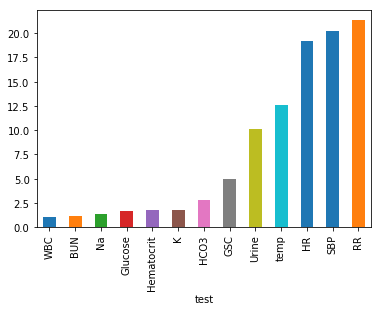

In [14]:
# Calculating the % of each repeated meaurements and plot the distribution

from matplotlib import pyplot

D=X['icustay_id','count']
D1=(D/D.sum())*100.0
D1=D1.sort_values(ascending=True)
D1.plot(kind='bar')
pyplot.show()

In [15]:
# check the distribution over hours

Y=pd.DataFrame(repeatedMeasures .groupby(['subject_id','test','diff'])[['valuenum']].mean())
Y

valuenum
subject_id test    diff            
3          BUN     3      42.000000
                   10     42.000000
                   35     36.000000
           GSC     9       3.000000
                   13      3.000000
                   23      6.000000
                   29      6.000000
                   31     11.000000
                   37     10.000000
                   41     10.000000
                   45     10.000000
           Glucose 3     212.000000
                   5     267.000000
                   8     299.000000
                   9     294.000000
                   10    293.000000
                   20    157.000000
                   31    128.000000
                   35    133.000000
           HCO3    2      23.000000
                   3      16.250000
                   5      15.000000
                   8      15.000000
                   9      15.000000
                   10     14.500000
                   16     18.500000
                   18     17.000000
                   20     17.000000
                   23     19.500000
                   25     18.500000
...                             ...
9999       SBP     19    121.000000
                   20    123.000000
                   21    120.000000
                   22    119.000000
                   23    108.000000
                   24    104.000000
                   26     96.000000
           Urine   1      60.000000
                   2      45.000000
                   3      25.000000
                   4      15.000000
                   5      20.000000
                   6      15.000000
                   7      35.000000
                   8      25.000000
                   9      30.000000
                   10     35.000000
                   11     45.000000
                   12     15.000000
                   14     60.000000
                   15     35.000000
                   16     40.000000
           WBC     1       9.400000
                   10     10.600000
           temp    2      35.833317
                   6      35.555577
                   10     35.666682
                   13     35.777790
                   18     36.111105
                   22     35.944422

[286767 rows x 1 columns]

### From row-based to column-based measurements 

We need to transfer the readings per visit to one row holding the whole predictors and the outome of each visit

In [16]:
#Group by patid,visitod, name_of_test, and the avearge  --- this is not the best way to represent each hour value

from collections import OrderedDict

interestedGroups=repeatedMeasures.groupby(['subject_id','icustay_id','diff','test'])['valuenum']
listOfGroups=list(interestedGroups.groups.keys())
meanValues=list(interestedGroups.mean())
dictInterestedGroups={}
count=0
for (l1,l2,l3,l4) in listOfGroups:
    dictInterestedGroups.setdefault(str(l1)+":"+str(l2),{}).setdefault(l3,{}).update({l4:meanValues[count]})
    count +=1
dictInterestedGroups

{'3040:3772': {1: {'Glucose': 93.0,
   'HCO3': 36.05557780795627,
   'K': 88.0,
   'Na': 11.625},
  2: {'HR': 4.1,
   'RR': 20.333333333333332,
   'SBP': 40.0,
   'Urine': 13.0,
   'temp': 30.0},
  3: {'GSC': 27.5, 'HR': 60.0, 'RR': 25.0, 'SBP': 23.0, 'Urine': 16.0},
  4: {'GSC': 110.0, 'HR': 4.5, 'RR': 104.0, 'SBP': 76.0, 'Urine': 19.0},
  5: {'HR': 26.0, 'Hematocrit': 124.0, 'RR': 15.0, 'SBP': 20.0, 'Urine': 5.0},
  6: {'BUN': 29.0,
   'GSC': 8.0,
   'Glucose': 119.0,
   'HCO3': 94.5,
   'HR': 44.0,
   'K': 94.0,
   'Na': 14.0,
   'RR': 80.0,
   'SBP': 50.0,
   'Urine': 4.0,
   'WBC': 9.8,
   'temp': 134.0},
  7: {'HCO3': 95.0, 'HR': 20.0, 'RR': 109.0, 'SBP': 159.0, 'Urine': 81.0},
  8: {'GSC': 141.0, 'HR': 101.0, 'RR': 10.0, 'SBP': 126.0, 'Urine': 114.0},
  9: {'GSC': 156.0,
   'HR': 16.0,
   'RR': 26.5,
   'SBP': 62.0,
   'Urine': 17.0,
   'temp': 60.0},
  10: {'HR': 93.5, 'RR': 94.0, 'SBP': 19.0, 'Urine': 138.0},
  11: {'GSC': 20.75,
   'HR': 134.0,
   'RR': 82.0,
   'SBP': 124.0,

In [17]:
#Prepare a row-based features

icuTestsList=['GSC','Glucose','Hematocrit','HR','RR','SBP','temp', 'HCO3', 'BUN', 'K','Na','WBC','Urine']
icuTests=OrderedDict()
icuTests['subject_id']=[]
icuTests['icustay_id']=[]
for i in range (1,49):
          for c in icuTestsList:
            icuTests[c+"_"+str(i)]=[]
listOfICUKeys=list(icuTests.keys())
listOfICUKeys

['subject_id',
 'icustay_id',
 'GSC_1',
 'Glucose_1',
 'Hematocrit_1',
 'HR_1',
 'RR_1',
 'SBP_1',
 'temp_1',
 'HCO3_1',
 'BUN_1',
 'K_1',
 'Na_1',
 'WBC_1',
 'Urine_1',
 'GSC_2',
 'Glucose_2',
 'Hematocrit_2',
 'HR_2',
 'RR_2',
 'SBP_2',
 'temp_2',
 'HCO3_2',
 'BUN_2',
 'K_2',
 'Na_2',
 'WBC_2',
 'Urine_2',
 'GSC_3',
 'Glucose_3',
 'Hematocrit_3',
 'HR_3',
 'RR_3',
 'SBP_3',
 'temp_3',
 'HCO3_3',
 'BUN_3',
 'K_3',
 'Na_3',
 'WBC_3',
 'Urine_3',
 'GSC_4',
 'Glucose_4',
 'Hematocrit_4',
 'HR_4',
 'RR_4',
 'SBP_4',
 'temp_4',
 'HCO3_4',
 'BUN_4',
 'K_4',
 'Na_4',
 'WBC_4',
 'Urine_4',
 'GSC_5',
 'Glucose_5',
 'Hematocrit_5',
 'HR_5',
 'RR_5',
 'SBP_5',
 'temp_5',
 'HCO3_5',
 'BUN_5',
 'K_5',
 'Na_5',
 'WBC_5',
 'Urine_5',
 'GSC_6',
 'Glucose_6',
 'Hematocrit_6',
 'HR_6',
 'RR_6',
 'SBP_6',
 'temp_6',
 'HCO3_6',
 'BUN_6',
 'K_6',
 'Na_6',
 'WBC_6',
 'Urine_6',
 'GSC_7',
 'Glucose_7',
 'Hematocrit_7',
 'HR_7',
 'RR_7',
 'SBP_7',
 'temp_7',
 'HCO3_7',
 'BUN_7',
 'K_7',
 'Na_7',
 'WBC_7',
 '

In [18]:
patientKeys=admPat[['subject_id', 'icustay_id']]

for i in range(0, len(patientKeys)):
    myDict=dict((e1, None) for e1 in listOfICUKeys)
    myDict['subject_id'] = patientKeys['subject_id'][i]
    myDict['icustay_id'] = patientKeys['icustay_id'][i]
    aKey=str(patientKeys['subject_id'][i])+":"+str(patientKeys['icustay_id'][i])
    if (aKey in dictInterestedGroups.keys()):
        for k1 in dictInterestedGroups[aKey].keys():
            for k2 in dictInterestedGroups[aKey][k1].keys():
                myDict[k2+"_"+str(k1)]=dictInterestedGroups[aKey][k1][k2]
                #print(k1,k2)
    for k in myDict.keys():
        icuTests[k].append(myDict[k])
icuTests

OrderedDict([('subject_id',
              [3,
               12,
               21,
               21,
               26,
               31,
               37,
               56,
               61,
               61,
               61,
               78,
               83,
               94,
               94,
               105,
               105,
               106,
               112,
               112,
               117,
               117,
               124,
               124,
               146,
               148,
               149,
               150,
               157,
               157,
               176,
               177,
               177,
               177,
               177,
               181,
               184,
               184,
               224,
               235,
               261,
               283,
               283,
               286,
               287,
               287,
               294,
               301,
               308,
        

In [20]:
icuTestsDataFrame=pd.DataFrame()
icuTestsDataFrame=pd.DataFrame.from_dict(icuTests)
print(len(icuTestsDataFrame))
icuTestsDataFrame[icuTestsDataFrame['subject_id']==21]

1874


,subject_id,icustay_id,GSC_1,Glucose_1,Hematocrit_1,HR_1,RR_1,SBP_1,temp_1,HCO3_1,...,HR_48,RR_48,SBP_48,temp_48,HCO3_48,BUN_48,K_48,Na_48,WBC_48,Urine_48
2,21,23,NaN,NaN,84.0,NaN,NaN,NaN,NaN,NaN,...,80.0,28.0,26.000000,NaN,NaN,NaN,NaN,NaN,NaN,84.0
3,21,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,6.2,127.0,26.333333,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
# Null distributions of the repeated measurements:
seriesM=100*icuTestsDataFrame.isnull().sum()/len(icuTestsDataFrame)
seriesM

subject_id        0.000000
icustay_id        0.000000
GSC_1            60.565635
Glucose_1        79.935966
Hematocrit_1     81.536820
HR_1             43.810032
RR_1             44.503735
SBP_1            44.290288
temp_1           58.164354
HCO3_1           73.959445
BUN_1            88.633938
K_1              78.335112
Na_1             83.084312
WBC_1            88.687300
Urine_1          70.170758
GSC_2            64.407684
Glucose_2        80.896478
Hematocrit_2     82.390608
HR_2             21.558164
RR_2             24.066169
SBP_2            22.838847
temp_2           64.567769
HCO3_2           74.279616
BUN_2            87.673426
K_2              80.042689
Na_2             83.991462
WBC_2            88.580576
Urine_2          54.268943
GSC_3            68.890075
Glucose_3        82.710779
                   ...    
K_46             95.304162
Na_46            96.744931
WBC_46           97.385272
Urine_46         61.045891
GSC_47           80.736393
Glucose_47       95.517609
H

## <span style="color:blue"> **Question 4** </span>
<span style="color:blue"> How do we interpret the distributions of nulls? </span>

In [22]:
#Check the # of records and the length of features
#Merge [join] the two tables on the same feature names 

print(len(admPat))
print(len(admPat.columns))
print(len(icuTestsDataFrame))
print(len(icuTestsDataFrame.columns))

newICUPat=pd.merge(admPat,icuTestsDataFrame)
print(len(newICUPat))
print(len(newICUPat.columns))


1874
50
1874
626
1874
674


In [23]:
#Extract flags and outcomes from the tables)
patFlags=admPat[['subject_id', 'icustay_id', 'hadm_id', 'icustay_intime',
       'icustay_outtime', 'admit_dt', 'hospital_disch_dt','ICULOS', 'HOSLOS',
       'icustay_expire_flg', 'hospital_expire_flg']]
patFlags

,subject_id,icustay_id,hadm_id,icustay_intime,icustay_outtime,admit_dt,hospital_disch_dt,ICULOS,HOSLOS,icustay_expire_flg,hospital_expire_flg
0,3,4,2075,2682-09-07 18:12:00,2682-09-13 19:45:00,2682-09-07 00:00:00,2682-09-18 00:00:00,6.0,11.0,N,N
1,12,13,12532,2875-09-27 01:08:00,2875-10-04 16:22:00,2875-09-26 00:00:00,2875-10-09 00:00:00,8.0,13.0,N,Y
2,21,23,20666,3138-10-29 19:53:00,3138-11-04 17:32:00,3138-10-29 00:00:00,3138-11-11 00:00:00,6.0,13.0,N,Y
3,21,24,20882,3139-03-19 20:53:00,3139-03-28 05:39:00,3139-03-19 00:00:00,3139-03-28 00:00:00,8.0,9.0,Y,Y
4,26,29,15067,3079-03-04 08:52:00,3079-03-06 20:17:00,3079-03-03 00:00:00,3079-03-10 00:00:00,2.0,7.0,N,N
5,31,34,15325,2678-08-21 22:28:00,2678-08-29 20:59:00,2678-08-21 00:00:00,2678-08-29 00:00:00,8.0,8.0,Y,Y
6,37,41,18052,3264-08-16 11:01:00,3264-08-17 14:22:00,3264-08-14 00:00:00,3264-08-19 00:00:00,1.0,5.0,N,N
7,56,62,28766,2644-01-17 02:02:00,2644-01-18 22:25:00,2644-01-17 00:00:00,2644-01-23 00:00:00,2.0,6.0,N,Y
8,61,67,7149,3352-07-17 22:55:00,3352-07-20 12:21:00,3352-06-23 00:00:00,3352-07-26 00:00:00,3.0,33.0,N,Y
9,61,69,5712,3353-01-31 09:50:00,3353-01-31 09:54:00,3353-01-10 00:00:00,3353-02-09 00:00:00,0.0,30.0,N,Y


In [24]:
#Remove the identifiers, flages, and outcomes from the data and maintain the variables with at least 75% filled data

remICUPat=newICUPat.drop(['subject_id', 'icustay_id', 'hadm_id', 'icustay_intime','icustay_outtime', 'admit_dt', 'hospital_disch_dt','ICULOS', 'HOSLOS','icustay_expire_flg', 'hospital_expire_flg'], axis=1)
for col in remICUPat.columns:
    print(col,remICUPat[col].dtypes)   
seriesM=100*remICUPat.isnull().sum()/len(remICUPat)
print(seriesM)

L=seriesM[(seriesM.ix[:] < 25) & (seriesM.ix[:] >= 0)].axes
listofRemainingFeatues=L[0].tolist()

myData=remICUPat[listofRemainingFeatues]

sex object
ICUAGE float64
marital_status_descr object
ethnicity_descr object
overall_payor_group_descr object
religion_descr object
admission_type_descr object
height float64
weight_first float64
congestive_heart_failure float64
cardiac_arrhythmias float64
valvular_disease float64
pulmonary_circulation float64
peripheral_vascular float64
hypertension float64
paralysis float64
other_neurological float64
chronic_pulmonary float64
diabetes_uncomplicated float64
diabetes_complicated float64
hypothyroidism float64
renal_failure float64
liver_disease float64
peptic_ulcer float64
aids float64
lymphoma float64
metastatic_cancer float64
solid_tumor float64
rheumatoid_arthritis float64
coagulopathy float64
obesity float64
weight_loss float64
fluid_electrolyte float64
blood_loss_anemia float64
deficiency_anemias float64
alcohol_abuse float64
drug_abuse float64
psychoses float64
depression float64
GSC_1 float64
Glucose_1 float64
Hematocrit_1 float64
HR_1 float64
RR_1 float64
SBP_1 float64
temp_1 f

HCO3_44 float64
BUN_44 float64
K_44 float64
Na_44 float64
WBC_44 float64
Urine_44 float64
GSC_45 float64
Glucose_45 float64
Hematocrit_45 float64
HR_45 float64
RR_45 float64
SBP_45 float64
temp_45 float64
HCO3_45 float64
BUN_45 float64
K_45 float64
Na_45 float64
WBC_45 float64
Urine_45 float64
GSC_46 float64
Glucose_46 float64
Hematocrit_46 float64
HR_46 float64
RR_46 float64
SBP_46 float64
temp_46 float64
HCO3_46 float64
BUN_46 float64
K_46 float64
Na_46 float64
WBC_46 float64
Urine_46 float64
GSC_47 float64
Glucose_47 float64
Hematocrit_47 float64
HR_47 float64
RR_47 float64
SBP_47 float64
temp_47 float64
HCO3_47 float64
BUN_47 float64
K_47 float64
Na_47 float64
WBC_47 float64
Urine_47 float64
GSC_48 float64
Glucose_48 float64
Hematocrit_48 float64
HR_48 float64
RR_48 float64
SBP_48 float64
temp_48 float64
HCO3_48 float64
BUN_48 float64
K_48 float64
Na_48 float64
WBC_48 float64
Urine_48 float64
sex                           0.213447
ICUAGE                        0.000000
marital_stat

/opt/conda/lib/python3.5/site-packages/ipykernel_launcher.py:9: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  if __name__ == '__main__':


In [26]:
#Remove non-risky predictors using Chi-Squared and  Wilcoxon–Mann–Whitney test for categorical and numeric ones repecticely.
#We put the missing as UNK and mean to both respectvely.
#We decode the outcome and comorbidities to 1 and 0
#['congestive_heart_failure', 'cardiac_arrhythmias','valvular_disease', 'pulmonary_circulation', 'peripheral_vascular','hypertension', 'paralysis', 'other_neurological', 'chronic_pulmonary','diabetes_uncomplicated', 'diabetes_complicated', 'hypothyroidism','renal_failure', 'liver_disease', 'peptic_ulcer', 'aids', 'lymphoma','metastatic_cancer', 'solid_tumor', 'rheumatoid_arthritis','coagulopathy', 'obesity']

from sklearn import preprocessing
from scipy.stats import wilcoxon
import warnings
from sklearn.feature_selection import chi2
from sklearn.preprocessing import LabelEncoder
import numpy as np
from numpy import array


warnings.filterwarnings("ignore")
label_encoder = LabelEncoder()
patOutcome=label_encoder.fit_transform(patFlags['icustay_expire_flg'])

MinMaxPd = pd.DataFrame()

for col in myData.columns:
    if ((myData[col].dtypes=='object') or (col in ['congestive_heart_failure', 'cardiac_arrhythmias','valvular_disease', 'pulmonary_circulation', 'peripheral_vascular','hypertension', 'paralysis', 'other_neurological', 'chronic_pulmonary','diabetes_uncomplicated', 'diabetes_complicated', 'hypothyroidism','renal_failure', 'liver_disease', 'peptic_ulcer', 'aids', 'lymphoma','metastatic_cancer', 'solid_tumor', 'rheumatoid_arthritis','coagulopathy', 'obesity'])):
        patCol=myData[col].fillna('UNK')
        integer_encoded = label_encoder.fit_transform(patCol)
        _,p_value=chi2(integer_encoded.reshape(-1,1),patOutcome.reshape(-1,1))
        print(col,p_value.tolist()[0])
        if (p_value.tolist()[0]<=0.1):   #Should be 0.05
            MinMaxPd[col]=integer_encoded
    else:
        meanVal=myData[col].mean()
        patCol=myData[col].fillna(meanVal)
        temp=preprocessing.minmax_scale(patCol)
        _, p_value = wilcoxon(temp, patOutcome)
        print(col,p_value)
        if (p_value<=0.1):
            MinMaxPd[col]=temp

sex 0.06243804630764493
ICUAGE 2.280538133885736e-243
marital_status_descr 0.8180619093206827
ethnicity_descr 0.8402613118857729
overall_payor_group_descr 0.12767737748959734
religion_descr 1.2818198670717435e-18
admission_type_descr 0.1281560946736512
weight_first 1.236877716138378e-39
congestive_heart_failure 0.03742149992599879
cardiac_arrhythmias 0.2623713154019624
valvular_disease 0.0014050532384486402
pulmonary_circulation 0.01654849413595684
peripheral_vascular 0.3890747242775986
hypertension 0.1905736958963769
paralysis 0.18359968410557873
other_neurological 0.12516738280330128
chronic_pulmonary 0.16425816397964293
diabetes_uncomplicated 0.5569114494840615
diabetes_complicated 0.00040754355390481406
hypothyroidism 0.3548239718089198
renal_failure 0.22581521881572203
liver_disease 0.9965400458811285
peptic_ulcer 0.1783261998591686
aids 0.4765762039484558
lymphoma 0.017098277474242102
metastatic_cancer 0.9942704734575366
solid_tumor 0.34380957508184296
rheumatoid_arthritis 0.2248

In [27]:
MinMaxPd.columns   #How many variables

Index(['sex', 'ICUAGE', 'religion_descr', 'weight_first',
       'congestive_heart_failure', 'valvular_disease', 'pulmonary_circulation',
       'diabetes_complicated', 'lymphoma', 'weight_loss', 'fluid_electrolyte',
       'blood_loss_anemia', 'deficiency_anemias', 'alcohol_abuse',
       'drug_abuse', 'psychoses', 'depression', 'HR_2', 'RR_2', 'SBP_2',
       'HR_3', 'RR_3', 'SBP_3', 'HR_4', 'RR_4', 'SBP_4', 'HR_5', 'RR_5',
       'SBP_5', 'HR_6', 'RR_6', 'SBP_6', 'HR_7', 'RR_7', 'SBP_7', 'HR_8',
       'RR_8', 'SBP_8', 'HR_9', 'RR_9', 'SBP_9', 'HR_10', 'RR_10', 'SBP_10',
       'HR_11', 'RR_11', 'SBP_11', 'HR_12', 'RR_12', 'SBP_12', 'HR_13',
       'RR_13', 'SBP_13', 'HR_14', 'RR_14', 'SBP_14', 'HR_15', 'RR_15',
       'SBP_15', 'HR_16', 'RR_16', 'SBP_16', 'HR_17', 'RR_17', 'SBP_17',
       'HR_18', 'RR_18', 'SBP_18', 'HR_19', 'RR_19', 'SBP_19', 'HR_20',
       'RR_20', 'SBP_20', 'HR_21', 'RR_21', 'SBP_21', 'HR_22', 'RR_22',
       'SBP_22', 'HR_23', 'RR_23', 'SBP_23', 'HR_24', 'SBP

In [28]:
MinMaxPd

,sex,ICUAGE,religion_descr,weight_first,congestive_heart_failure,valvular_disease,pulmonary_circulation,diabetes_complicated,lymphoma,weight_loss,...,SBP_21,HR_22,RR_22,SBP_22,HR_23,RR_23,SBP_23,HR_24,SBP_24,HR_25
0,1,0.740385,3,0.429463,1,0,0,0,0,1.0,...,0.025511,0.006061,0.043529,0.023077,0.031690,0.044167,0.039506,0.023333,0.116522,0.216250
1,1,0.692308,9,0.332293,0,0,0,0,0,0.0,...,0.026667,0.010101,0.013529,0.013846,0.146479,0.026667,0.015556,0.014667,0.026087,0.031250
2,1,0.836538,9,0.290394,0,0,0,0,0,0.0,...,0.026667,0.006869,0.055686,0.030769,0.201408,0.040000,0.100000,0.081333,0.066280,0.015000
3,1,0.846154,9,0.283263,0,0,0,0,0,0.0,...,0.022222,0.064646,0.073529,0.172308,0.143662,0.026667,0.017778,0.054667,0.031304,0.090000
4,1,0.692308,3,0.342912,1,0,0,0,0,0.0,...,0.096889,0.027140,0.042277,0.105824,0.027230,0.180000,0.004889,0.046740,0.112338,0.087918
5,1,0.692308,3,0.327836,0,0,0,0,1,0.0,...,0.014667,0.005253,0.058235,0.053846,0.029577,0.113333,0.014444,0.012333,0.268696,0.038750
6,1,0.663462,9,0.342912,0,0,0,0,0,0.0,...,0.017778,0.029899,0.049412,0.141538,0.056338,0.028333,0.033333,0.053333,0.245217,0.143125
7,0,0.875000,11,0.217294,1,0,0,0,0,0.0,...,0.053333,0.040000,0.024118,0.172308,0.050845,0.153333,0.125000,0.013333,0.013565,0.018750
8,1,0.528846,3,0.243147,0,0,0,0,1,1.0,...,0.064000,0.008081,0.085294,0.105824,0.169014,0.216667,0.137778,0.010000,0.112338,0.021250
9,1,0.528846,3,0.342912,0,0,0,0,0,0.0,...,0.061489,0.027140,0.042277,0.105824,0.096068,0.113005,0.078494,0.046740,0.112338,0.087918


In [29]:
#Remove the identifiers, flages, and outcomes from the data and maintain the variables with at least 25% filled data

remICUPat=newICUPat.drop(['subject_id', 'icustay_id', 'hadm_id', 'icustay_intime','icustay_outtime', 'admit_dt', 'hospital_disch_dt','ICULOS', 'HOSLOS','icustay_expire_flg', 'hospital_expire_flg'], axis=1)
for col in remICUPat.columns:
    print(col,remICUPat[col].dtypes)   
seriesM=100*remICUPat.isnull().sum()/len(remICUPat)
print(seriesM)

L=seriesM[(seriesM.ix[:] < 75) & (seriesM.ix[:] >= 0)].axes
listofRemainingFeatues=L[0].tolist()

myData=remICUPat[listofRemainingFeatues]

sex object
ICUAGE float64
marital_status_descr object
ethnicity_descr object
overall_payor_group_descr object
religion_descr object
admission_type_descr object
height float64
weight_first float64
congestive_heart_failure float64
cardiac_arrhythmias float64
valvular_disease float64
pulmonary_circulation float64
peripheral_vascular float64
hypertension float64
paralysis float64
other_neurological float64
chronic_pulmonary float64
diabetes_uncomplicated float64
diabetes_complicated float64
hypothyroidism float64
renal_failure float64
liver_disease float64
peptic_ulcer float64
aids float64
lymphoma float64
metastatic_cancer float64
solid_tumor float64
rheumatoid_arthritis float64
coagulopathy float64
obesity float64
weight_loss float64
fluid_electrolyte float64
blood_loss_anemia float64
deficiency_anemias float64
alcohol_abuse float64
drug_abuse float64
psychoses float64
depression float64
GSC_1 float64
Glucose_1 float64
Hematocrit_1 float64
HR_1 float64
RR_1 float64
SBP_1 float64
temp_1 f

Glucose_44 float64
Hematocrit_44 float64
HR_44 float64
RR_44 float64
SBP_44 float64
temp_44 float64
HCO3_44 float64
BUN_44 float64
K_44 float64
Na_44 float64
WBC_44 float64
Urine_44 float64
GSC_45 float64
Glucose_45 float64
Hematocrit_45 float64
HR_45 float64
RR_45 float64
SBP_45 float64
temp_45 float64
HCO3_45 float64
BUN_45 float64
K_45 float64
Na_45 float64
WBC_45 float64
Urine_45 float64
GSC_46 float64
Glucose_46 float64
Hematocrit_46 float64
HR_46 float64
RR_46 float64
SBP_46 float64
temp_46 float64
HCO3_46 float64
BUN_46 float64
K_46 float64
Na_46 float64
WBC_46 float64
Urine_46 float64
GSC_47 float64
Glucose_47 float64
Hematocrit_47 float64
HR_47 float64
RR_47 float64
SBP_47 float64
temp_47 float64
HCO3_47 float64
BUN_47 float64
K_47 float64
Na_47 float64
WBC_47 float64
Urine_47 float64
GSC_48 float64
Glucose_48 float64
Hematocrit_48 float64
HR_48 float64
RR_48 float64
SBP_48 float64
temp_48 float64
HCO3_48 float64
BUN_48 float64
K_48 float64
Na_48 float64
WBC_48 float64
Urine_4

In [30]:
#Remove non-risky predictors using Chi-Squared and  Wilcoxon–Mann–Whitney test for categorical and numeric ones repecticely.
#We put the missing as UNK and mean to both respectvely.
#We decode the outcome and comorbidities to 1 and 0
#['congestive_heart_failure', 'cardiac_arrhythmias','valvular_disease', 'pulmonary_circulation', 'peripheral_vascular','hypertension', 'paralysis', 'other_neurological', 'chronic_pulmonary','diabetes_uncomplicated', 'diabetes_complicated', 'hypothyroidism','renal_failure', 'liver_disease', 'peptic_ulcer', 'aids', 'lymphoma','metastatic_cancer', 'solid_tumor', 'rheumatoid_arthritis','coagulopathy', 'obesity']

from sklearn import preprocessing
from scipy.stats import wilcoxon
import warnings
from sklearn.feature_selection import chi2
from sklearn.preprocessing import LabelEncoder
import numpy as np
from numpy import array


warnings.filterwarnings("ignore")
label_encoder = LabelEncoder()
patOutcome=label_encoder.fit_transform(patFlags['icustay_expire_flg'])

MinMaxPd1 = pd.DataFrame()

for col in myData.columns:
    if ((myData[col].dtypes=='object') or (col in ['congestive_heart_failure', 'cardiac_arrhythmias','valvular_disease', 'pulmonary_circulation', 'peripheral_vascular','hypertension', 'paralysis', 'other_neurological', 'chronic_pulmonary','diabetes_uncomplicated', 'diabetes_complicated', 'hypothyroidism','renal_failure', 'liver_disease', 'peptic_ulcer', 'aids', 'lymphoma','metastatic_cancer', 'solid_tumor', 'rheumatoid_arthritis','coagulopathy', 'obesity'])):
        patCol=myData[col].fillna('UNK')
        integer_encoded = label_encoder.fit_transform(patCol)
        _,p_value=chi2(integer_encoded.reshape(-1,1),patOutcome.reshape(-1,1))
        print(col,p_value.tolist()[0])
        if (p_value.tolist()[0]<=0.1):   #Should be 0.05
            MinMaxPd1[col]=integer_encoded
    else:
        meanVal=myData[col].mean()
        patCol=myData[col].fillna(meanVal)
        temp=preprocessing.minmax_scale(patCol)
        _, p_value = wilcoxon(temp, patOutcome)
        print(col,p_value)
        if (p_value<=0.1):
            MinMaxPd1[col]=temp

sex 0.06243804630764493
ICUAGE 2.280538133885736e-243
marital_status_descr 0.8180619093206827
ethnicity_descr 0.8402613118857729
overall_payor_group_descr 0.12767737748959734
religion_descr 1.2818198670717435e-18
admission_type_descr 0.1281560946736512
height 7.388341060081711e-270
weight_first 1.236877716138378e-39
congestive_heart_failure 0.03742149992599879
cardiac_arrhythmias 0.2623713154019624
valvular_disease 0.0014050532384486402
pulmonary_circulation 0.01654849413595684
peripheral_vascular 0.3890747242775986
hypertension 0.1905736958963769
paralysis 0.18359968410557873
other_neurological 0.12516738280330128
chronic_pulmonary 0.16425816397964293
diabetes_uncomplicated 0.5569114494840615
diabetes_complicated 0.00040754355390481406
hypothyroidism 0.3548239718089198
renal_failure 0.22581521881572203
liver_disease 0.9965400458811285
peptic_ulcer 0.1783261998591686
aids 0.4765762039484558
lymphoma 0.017098277474242102
metastatic_cancer 0.9942704734575366
solid_tumor 0.343809575081842

In [31]:
MinMaxPd1.columns   #How many variables

Index(['sex', 'ICUAGE', 'religion_descr', 'height', 'weight_first',
       'congestive_heart_failure', 'valvular_disease', 'pulmonary_circulation',
       'diabetes_complicated', 'lymphoma',
       ...
       'SBP_46', 'Urine_46', 'HR_47', 'RR_47', 'SBP_47', 'Urine_47', 'HR_48',
       'RR_48', 'SBP_48', 'Urine_48'],
      dtype='object', length=268)

In [32]:
len(MinMaxPd1.columns)

268

## Take-home message (Discussion)